<ipython-input-53-7c0da42f78e1>:55: DtypeWarning: Columns (13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


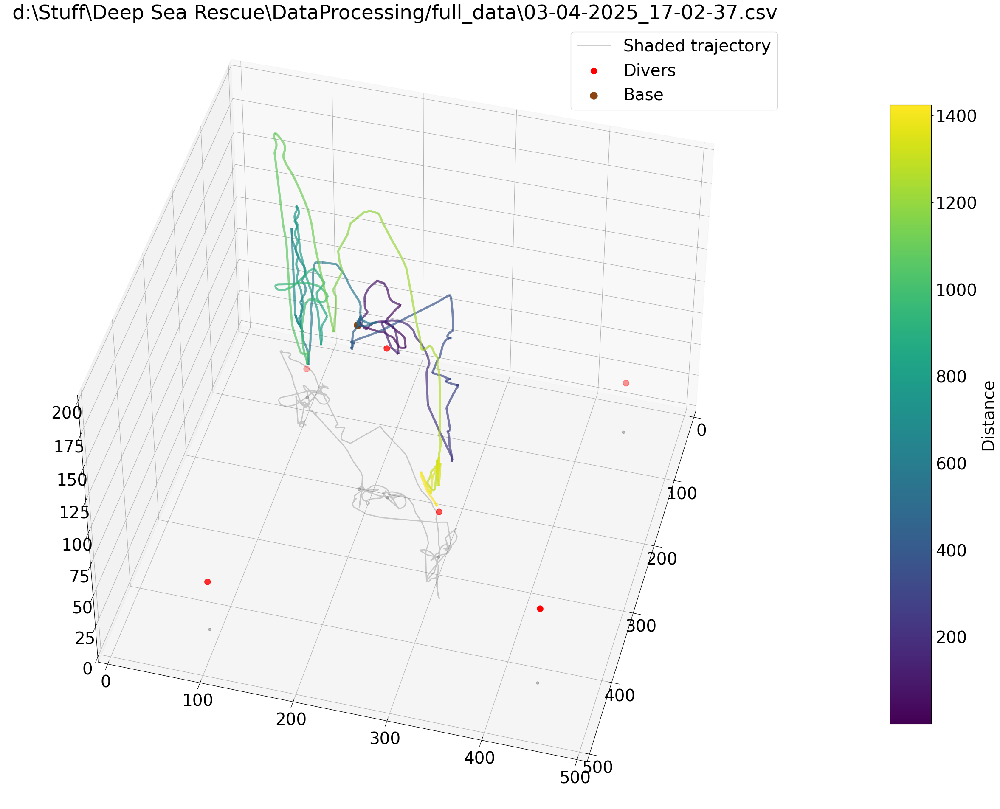

[0, 7013, 50490, 71027, 71197]


<ipython-input-53-7c0da42f78e1>:55: DtypeWarning: Columns (14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)


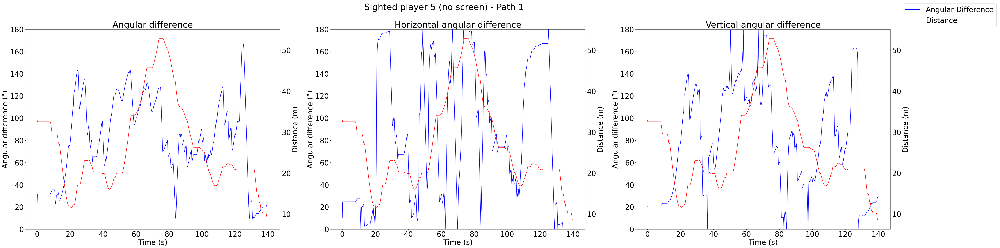

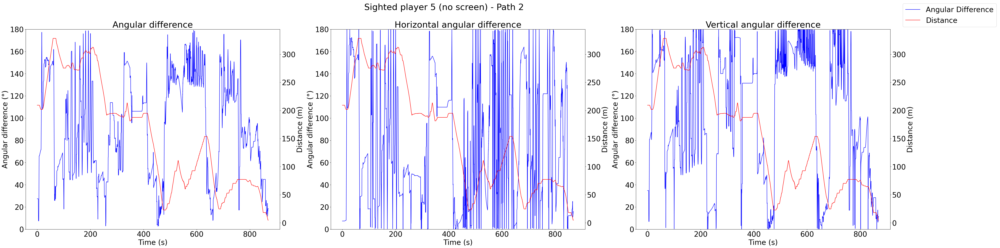

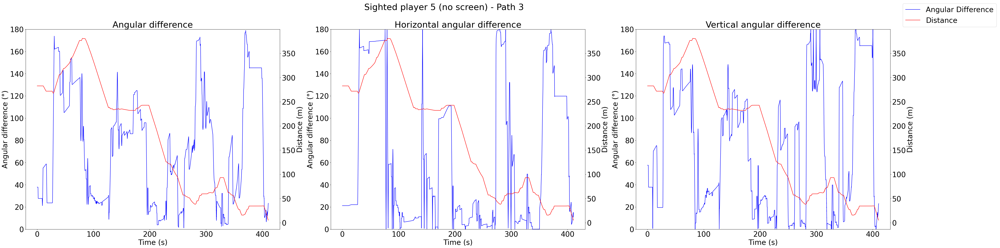

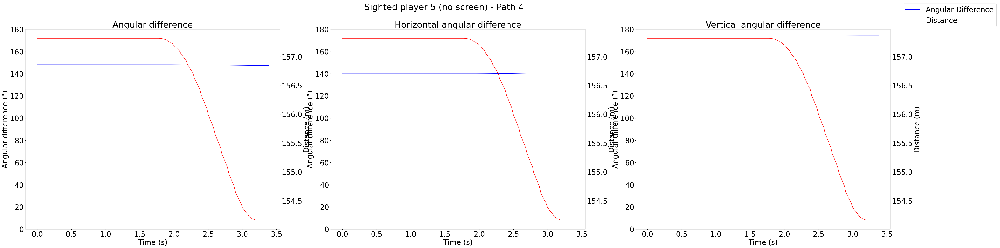

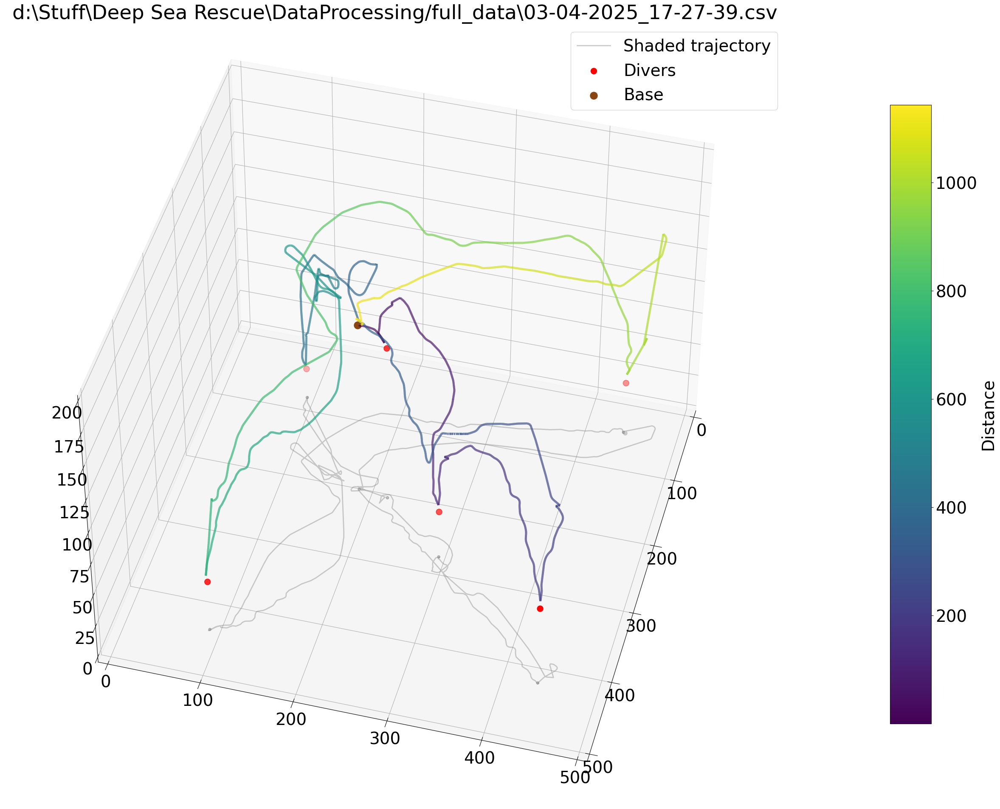

[0, 1176, 5821, 9965, 21788, 36139, 49063, 57147]


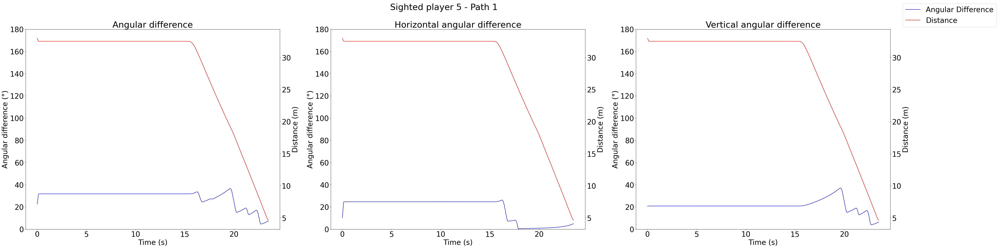

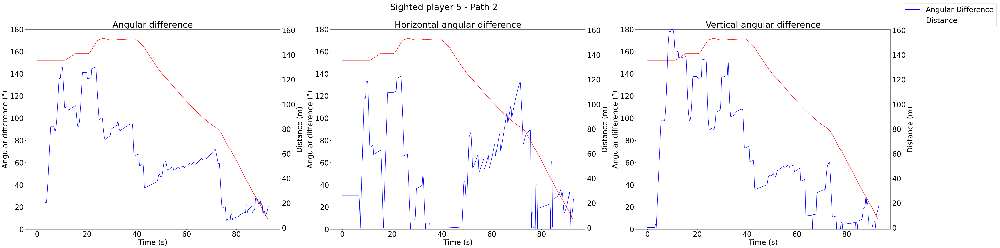

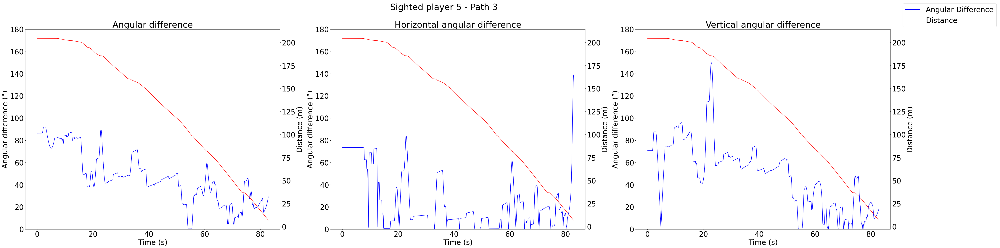

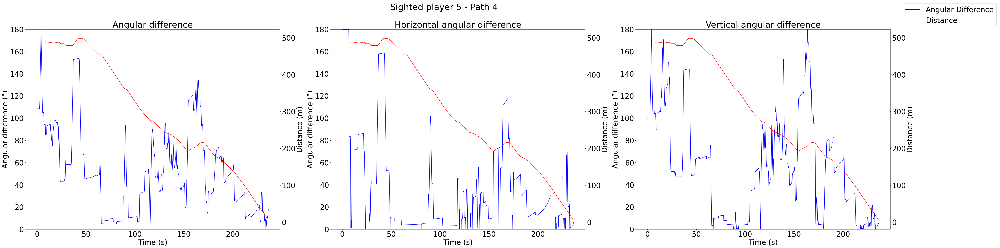

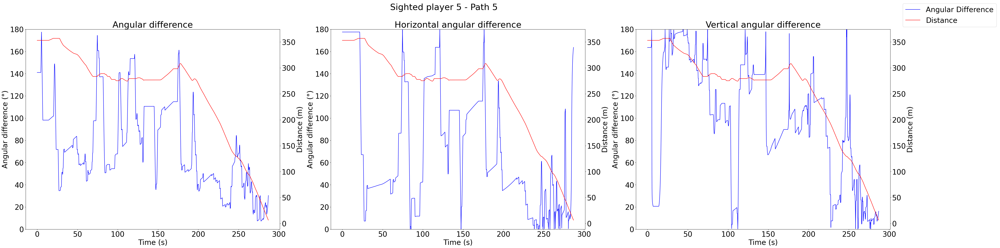

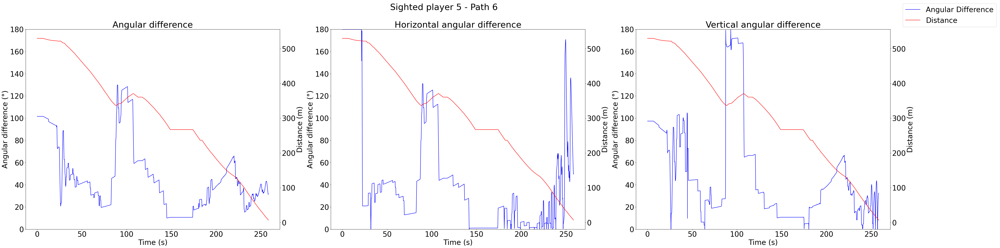

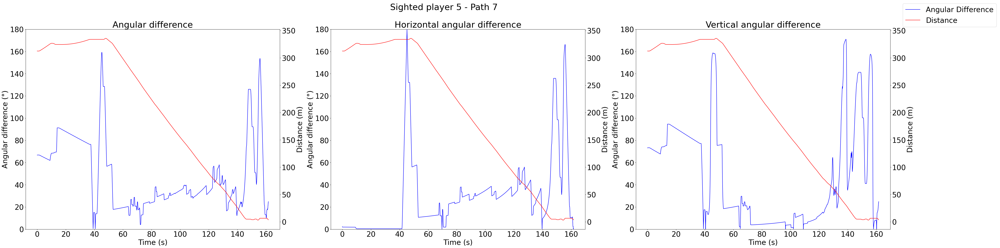

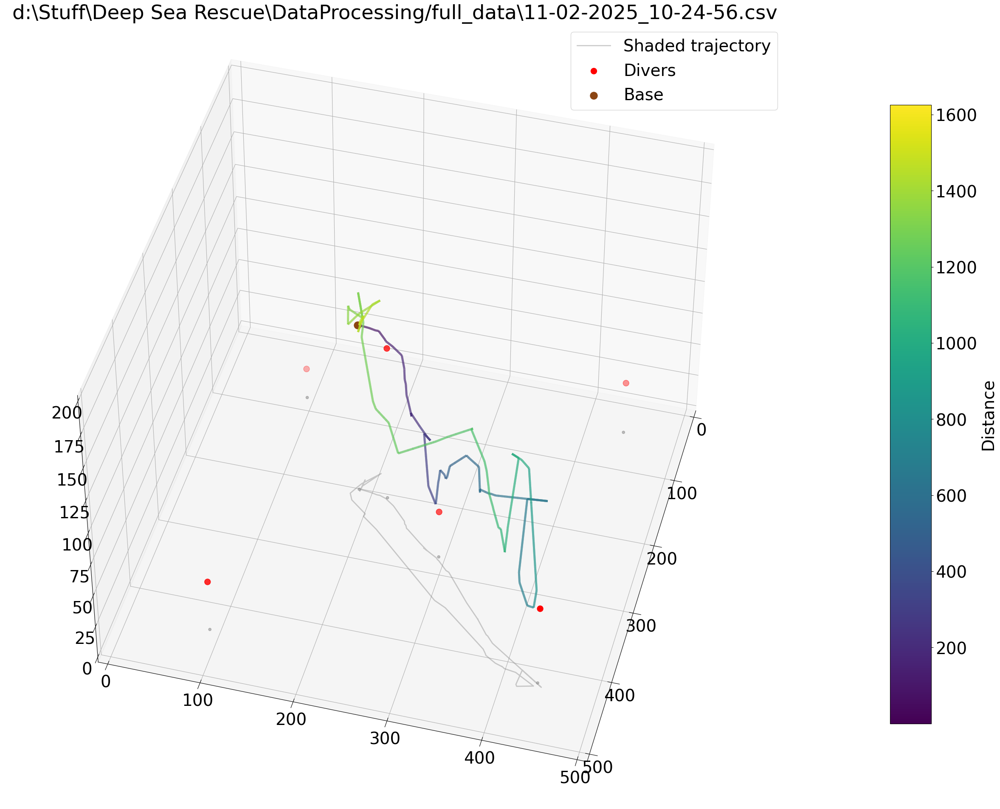

[0, 5241, 15788, 35430, 81264]


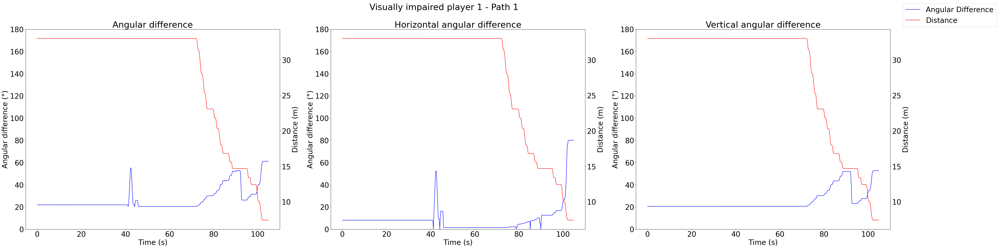

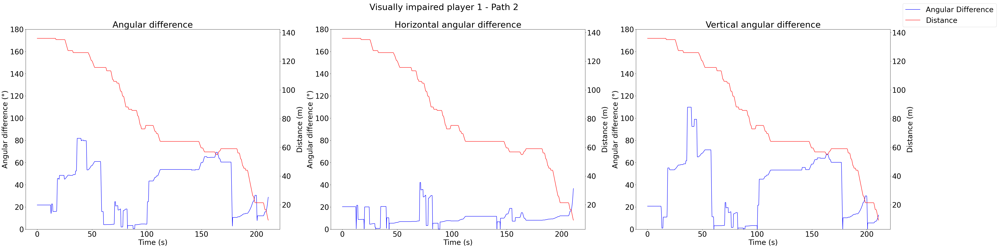

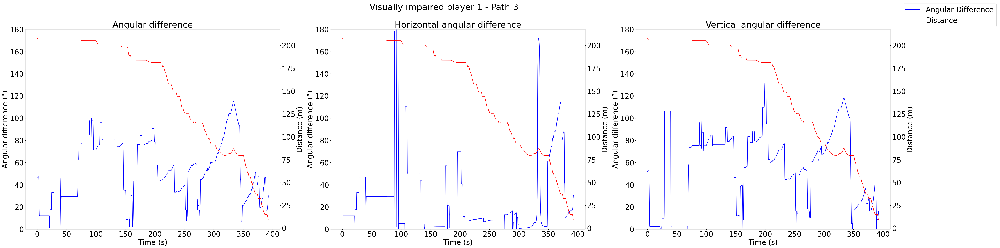

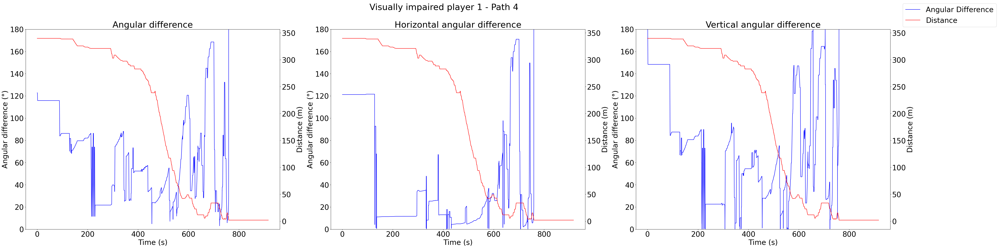

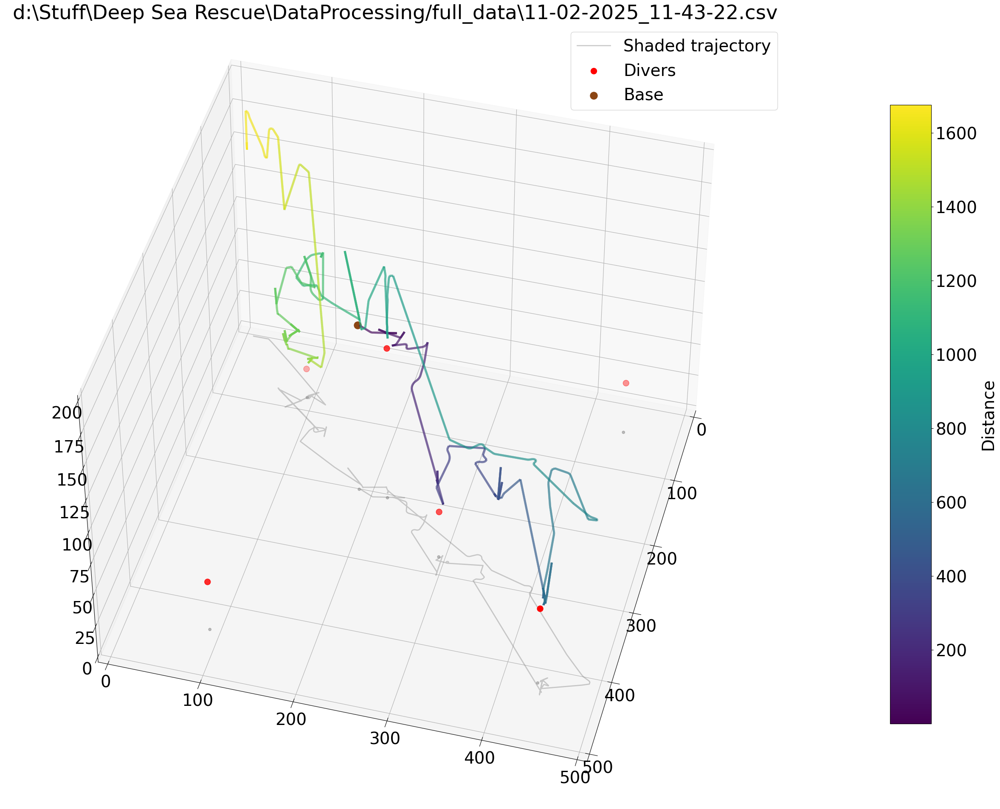

[0, 5019, 12711, 27675, 71027, 83767]


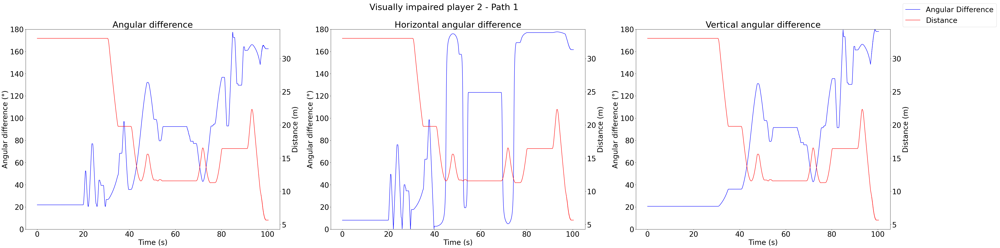

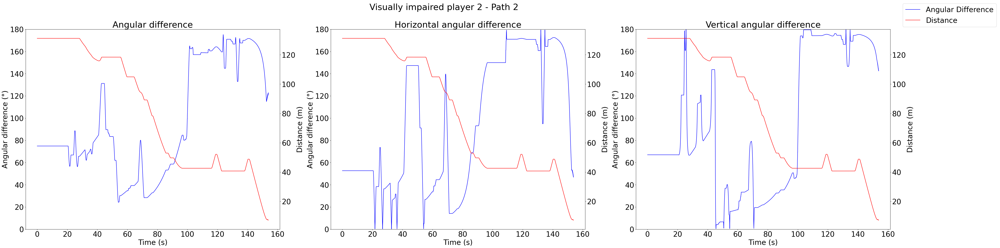

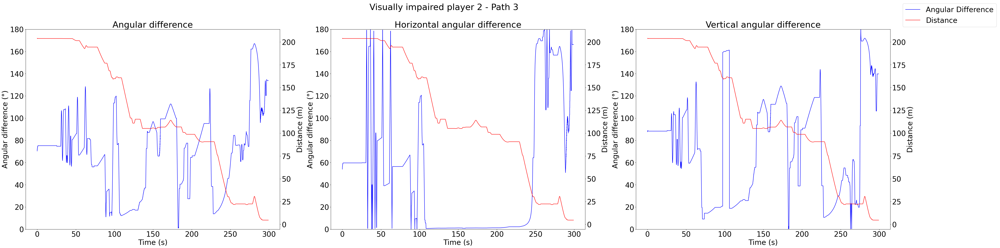

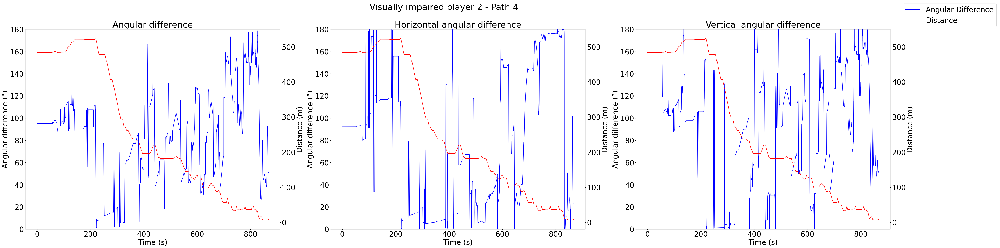

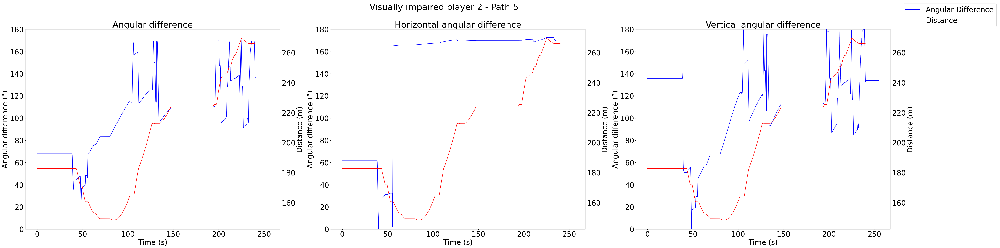

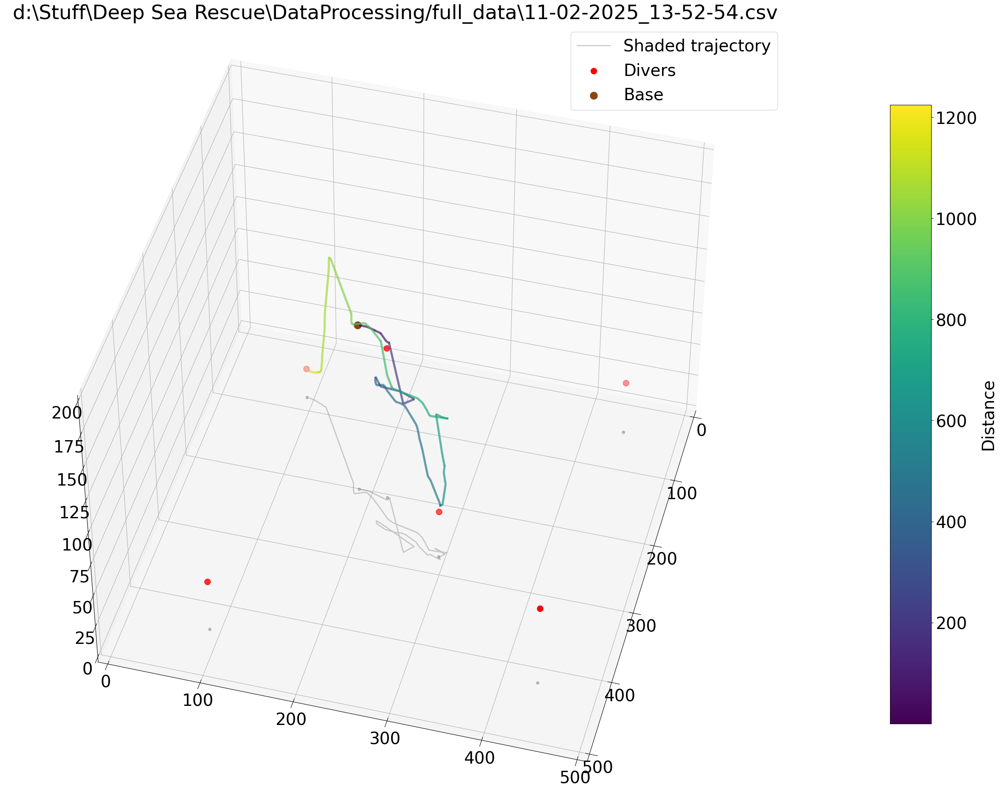

[0, 6586, 28936, 58071, 61219]


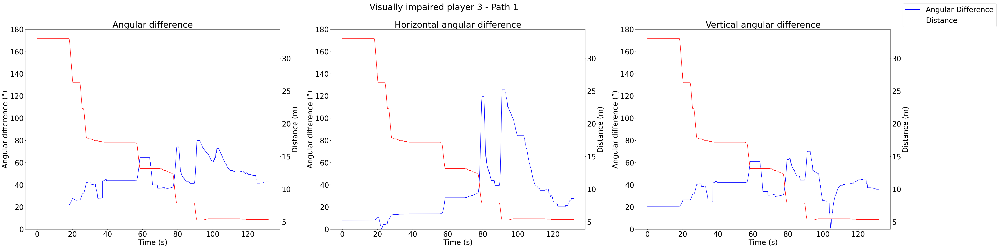

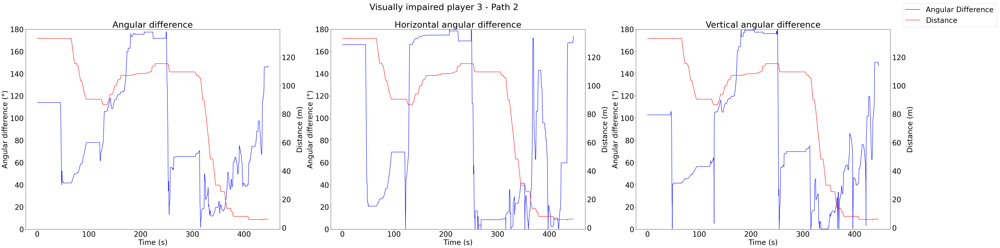

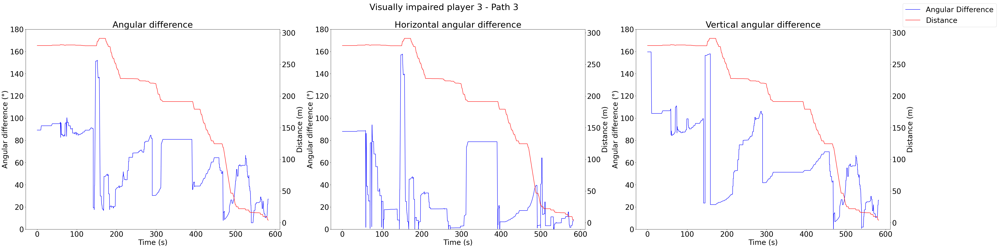

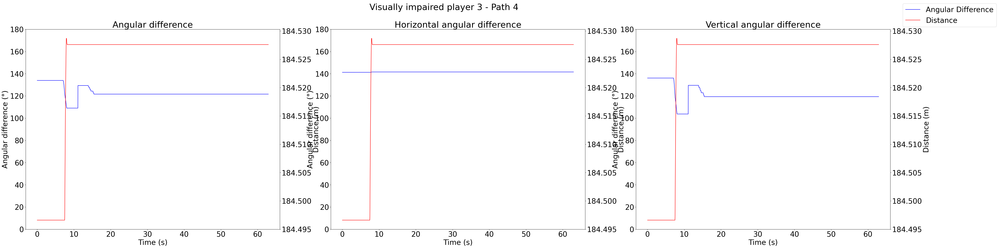

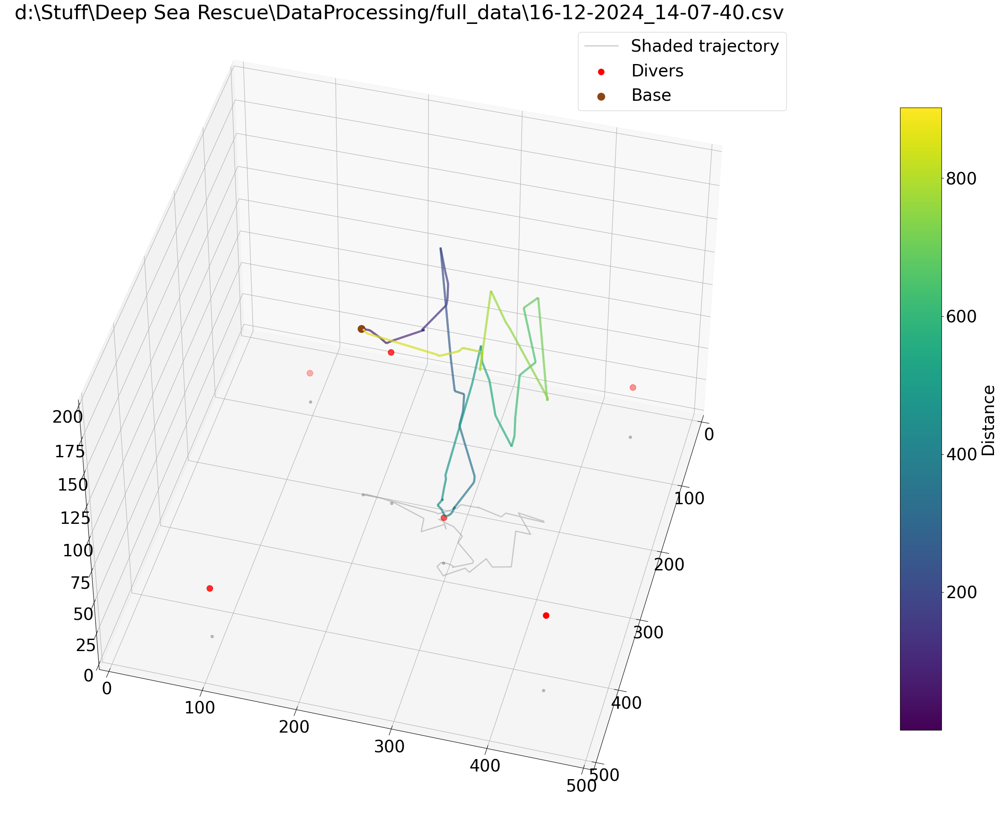

[0, 3791, 20234, 45107]


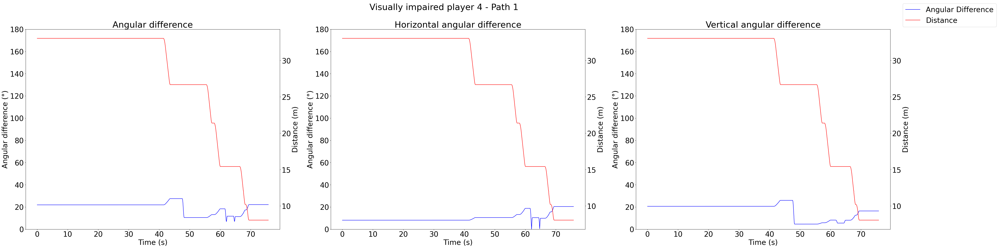

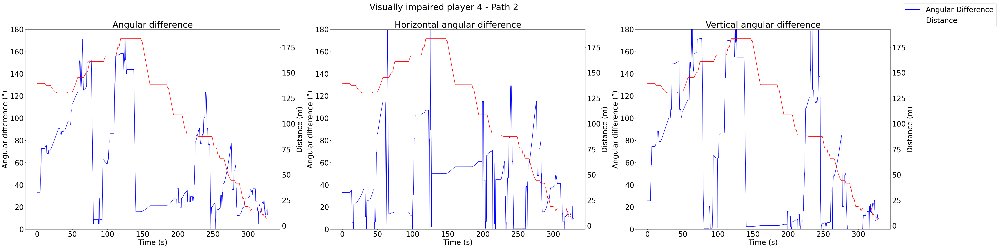

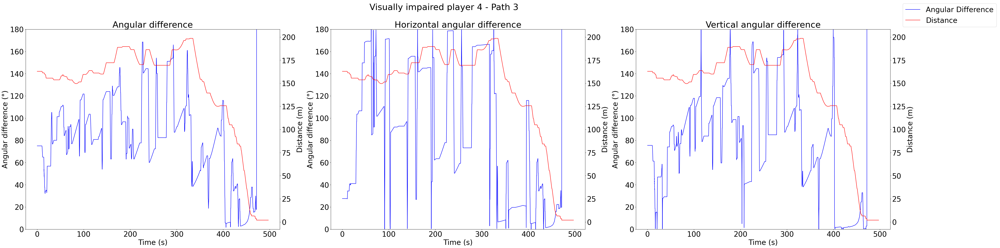

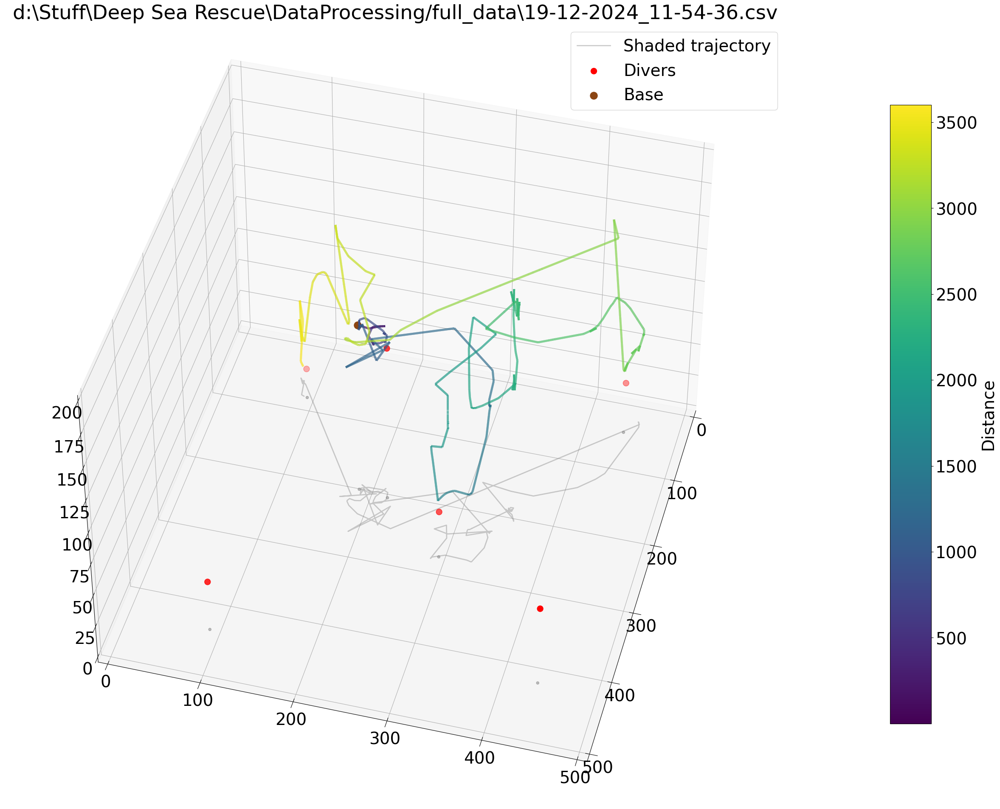

[0, 35259, 79709, 140143, 179381, 179986]


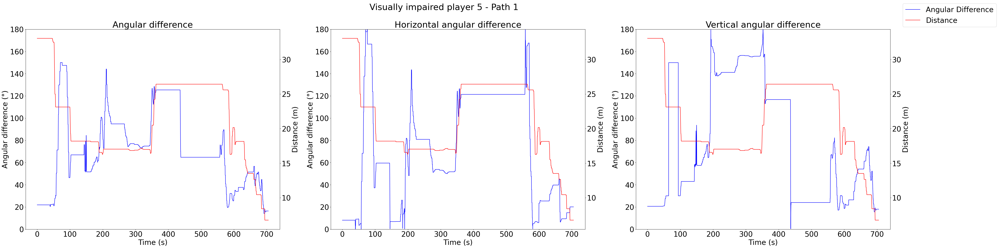

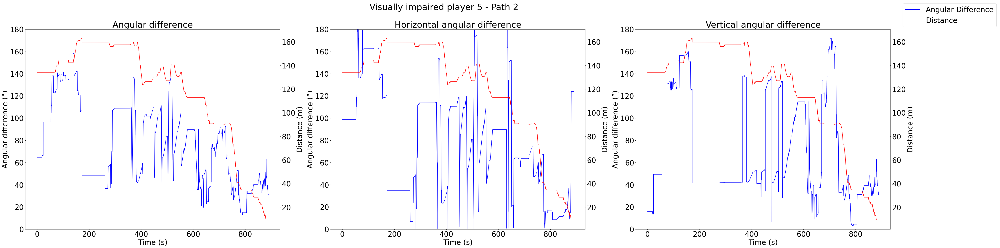

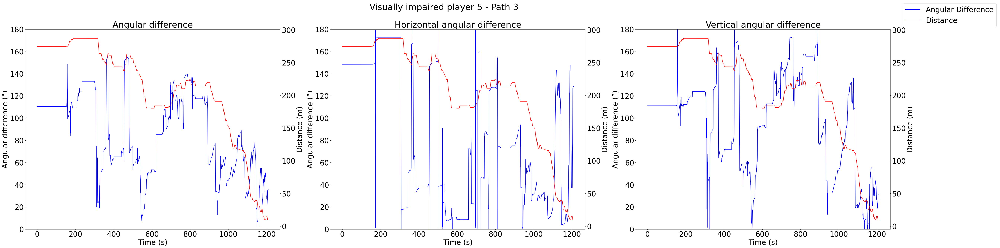

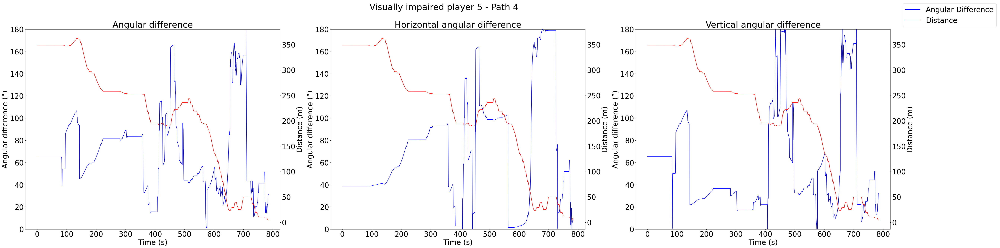

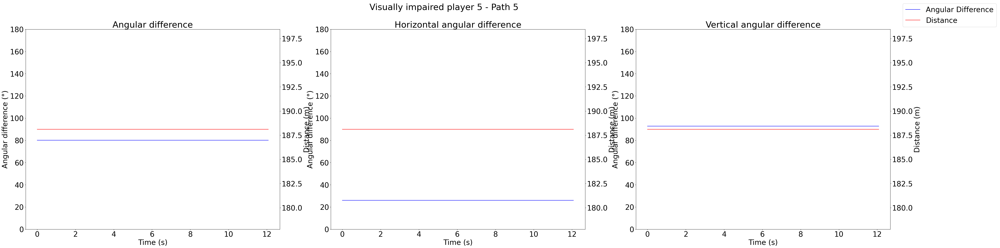

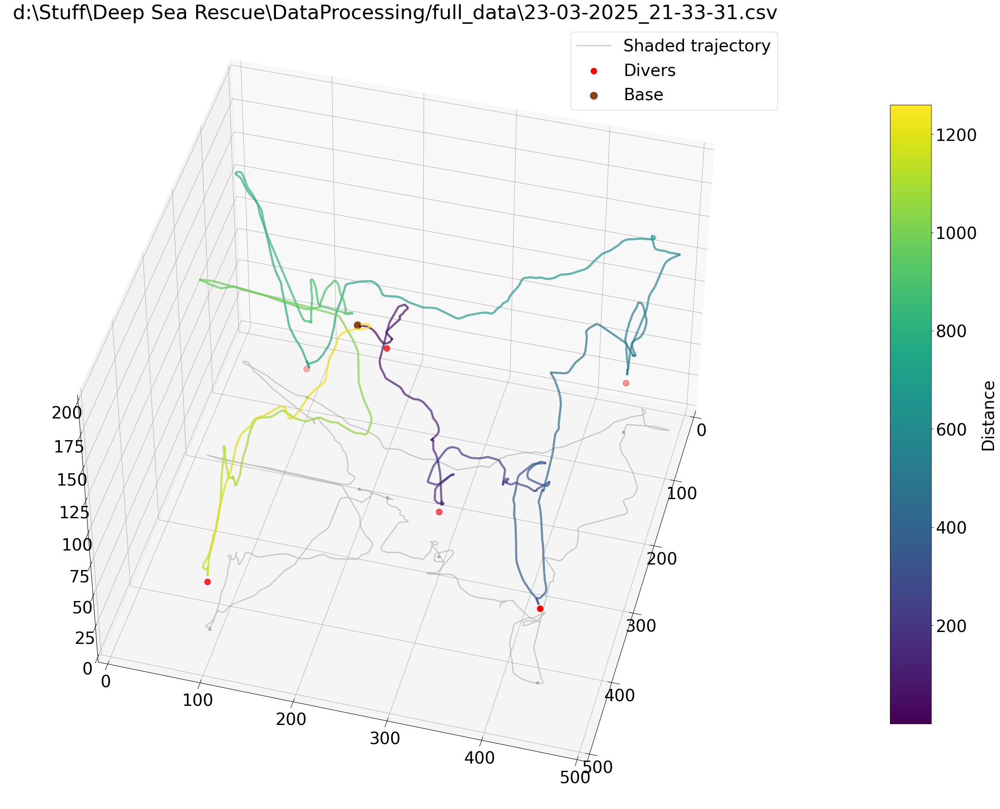

[0, 868, 8031, 18777, 28029, 38605, 58130, 62979]


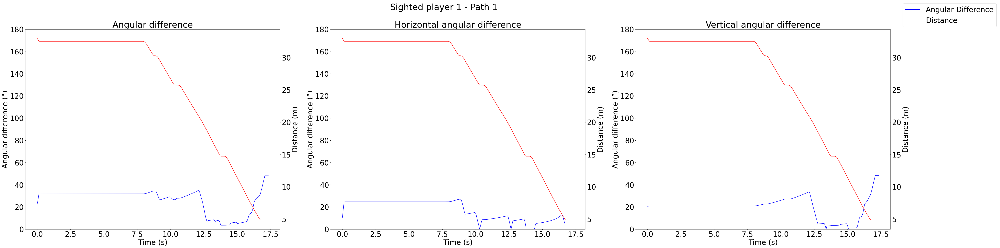

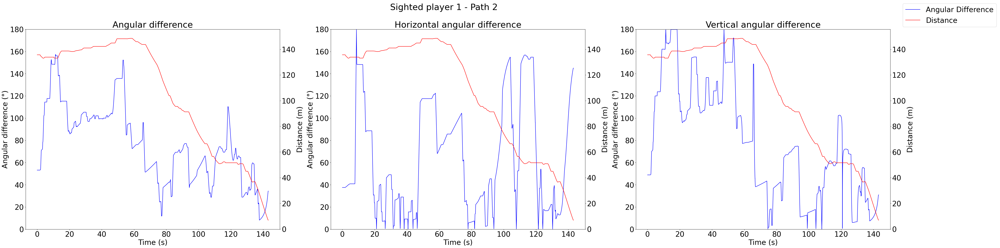

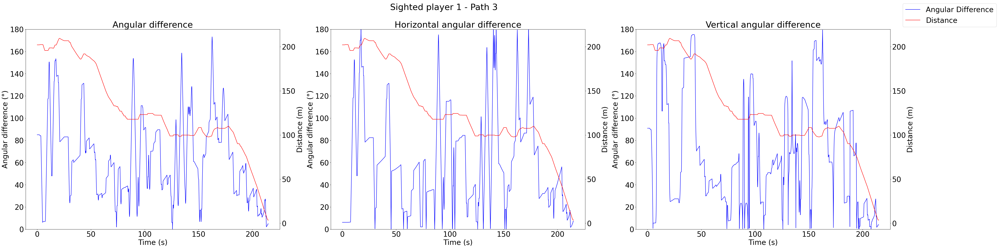

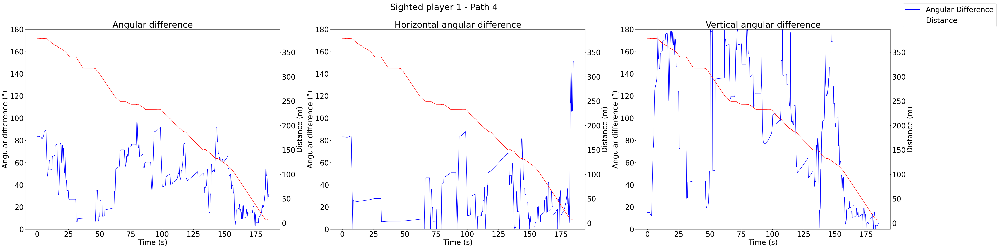

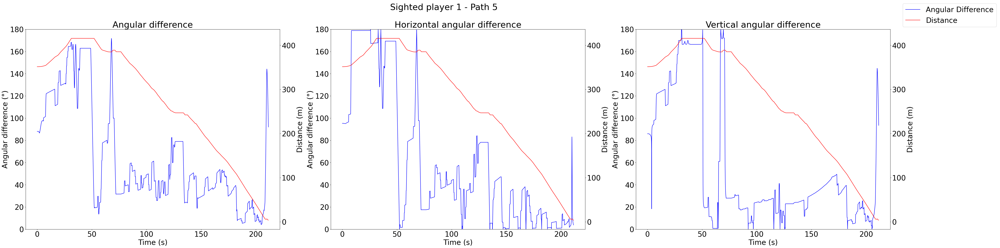

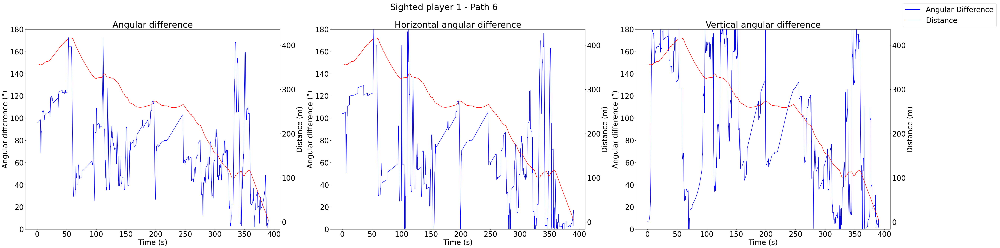

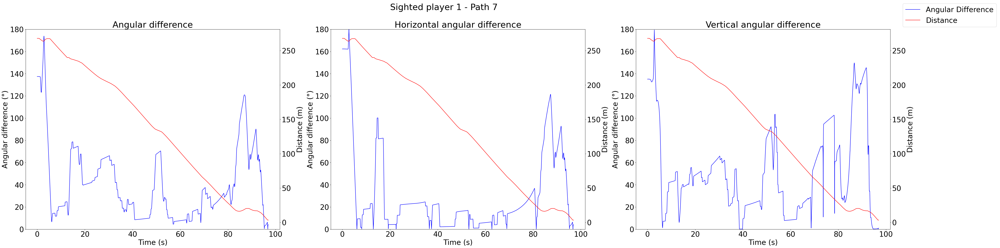

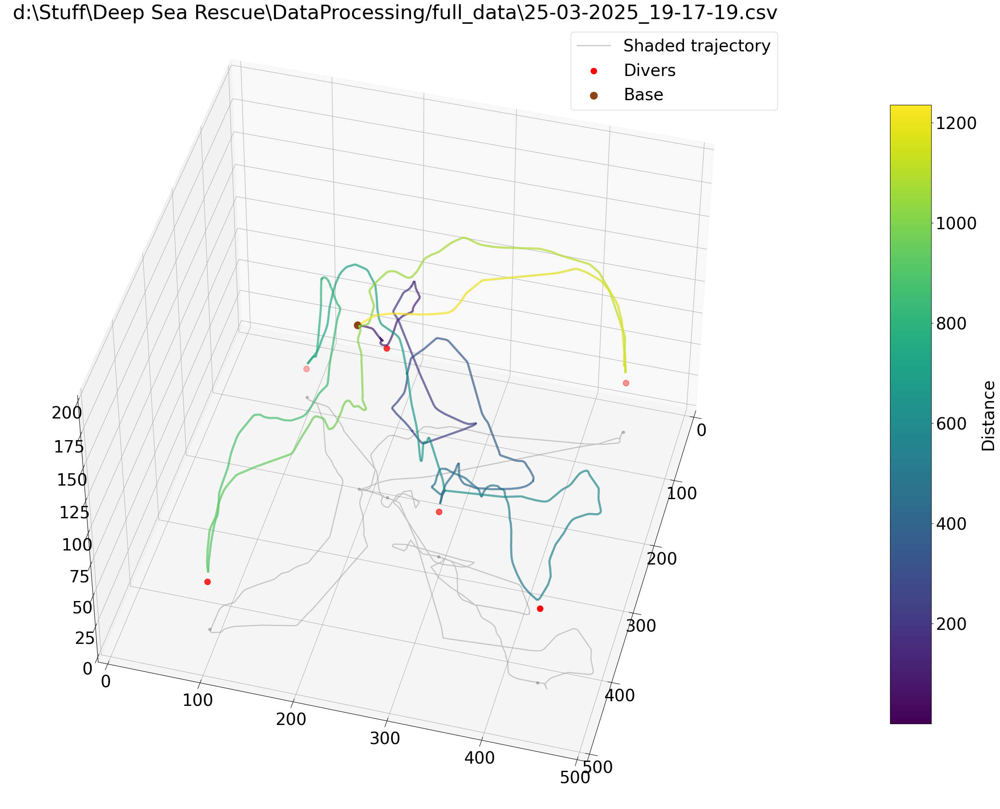

[0, 4552, 22298, 26426, 37987, 45521, 57003, 61756]


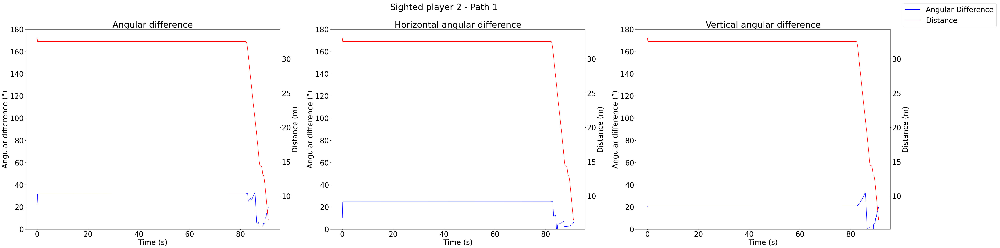

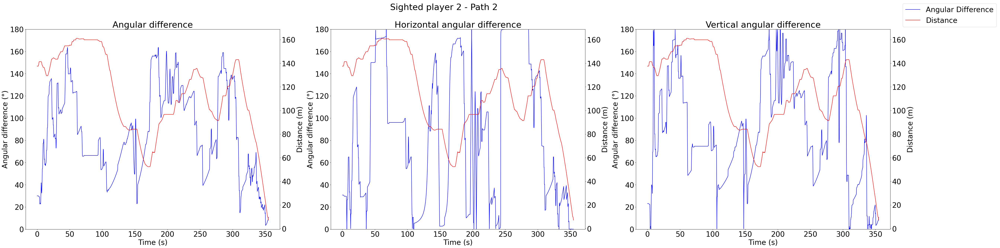

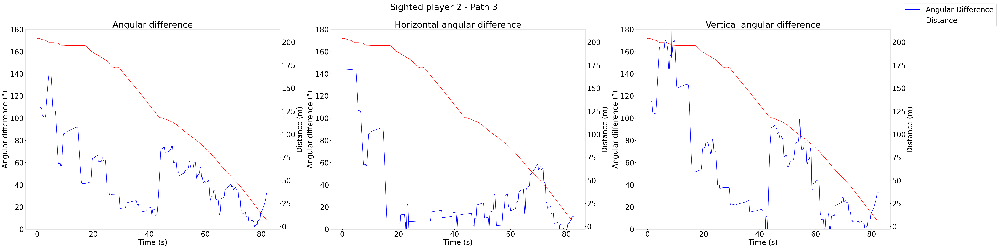

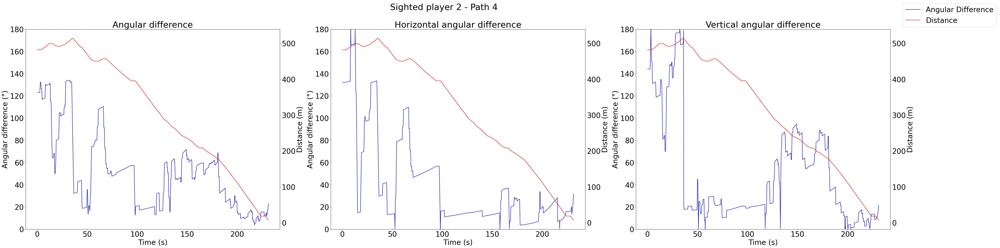

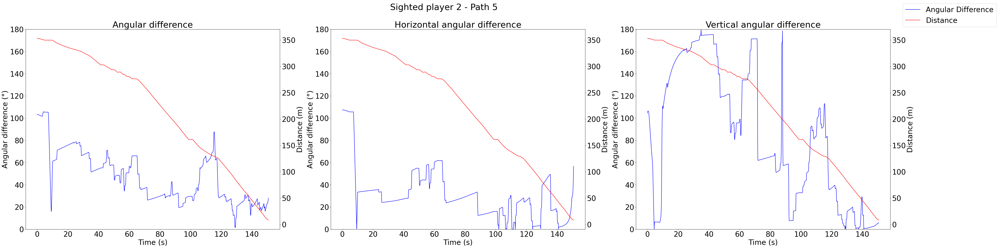

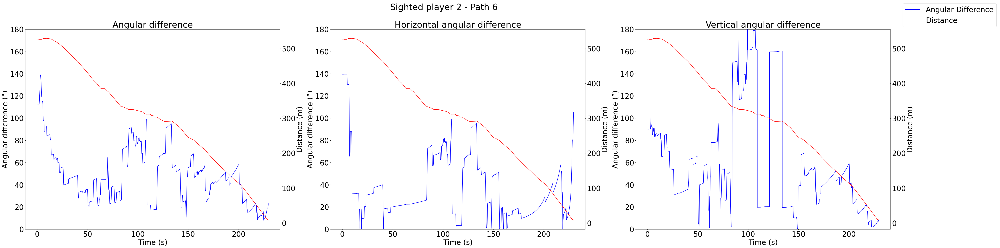

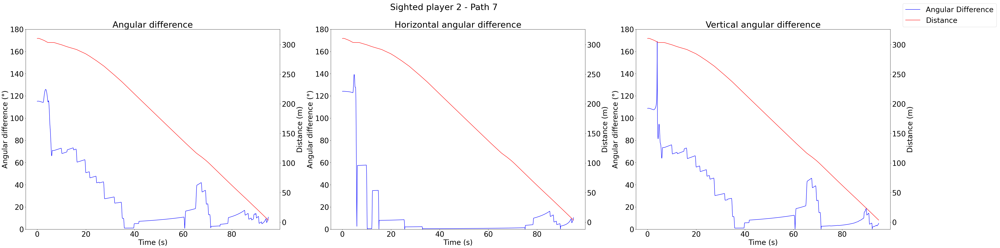

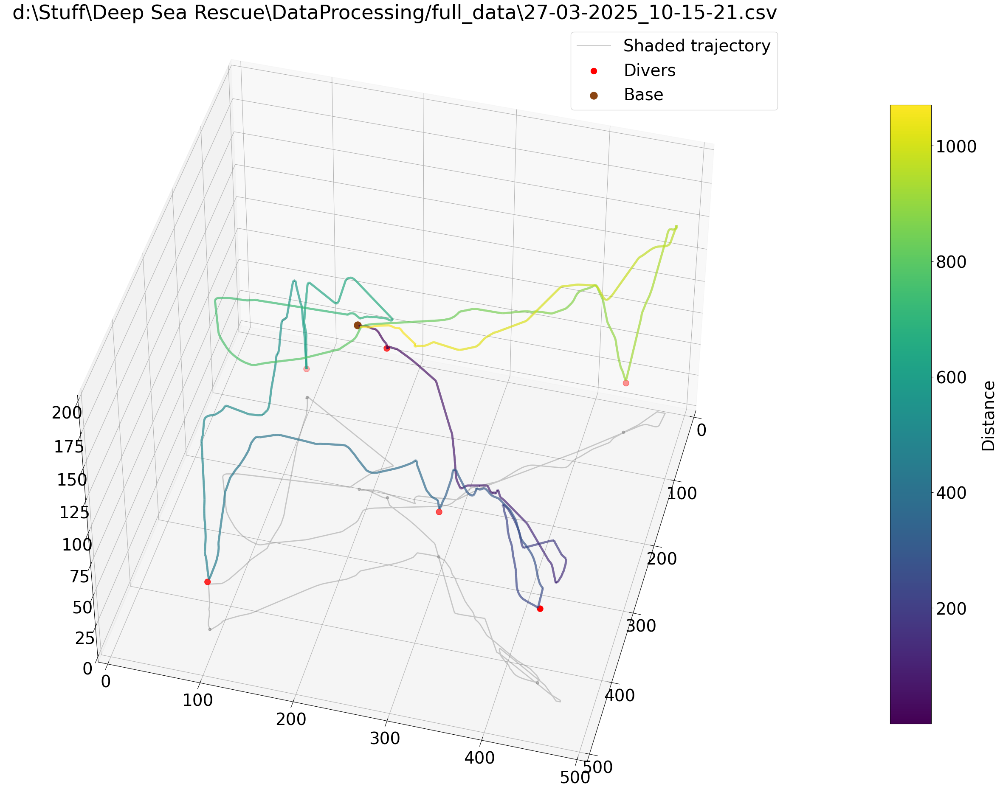

[0, 916, 12299, 16670, 22668, 30639, 45498, 53532]


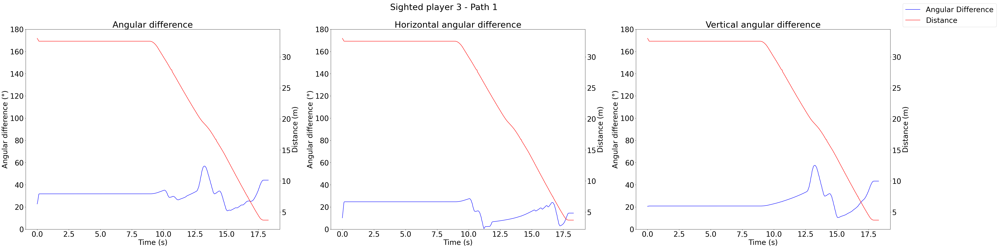

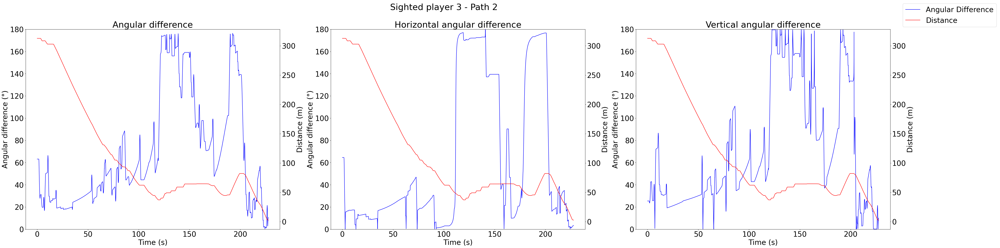

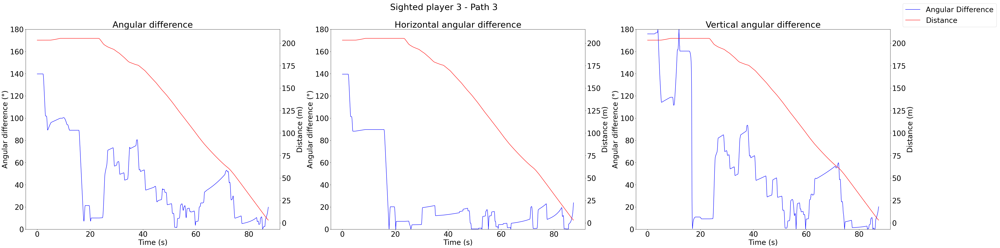

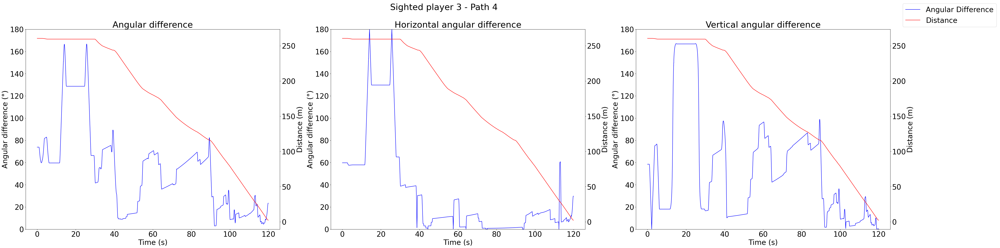

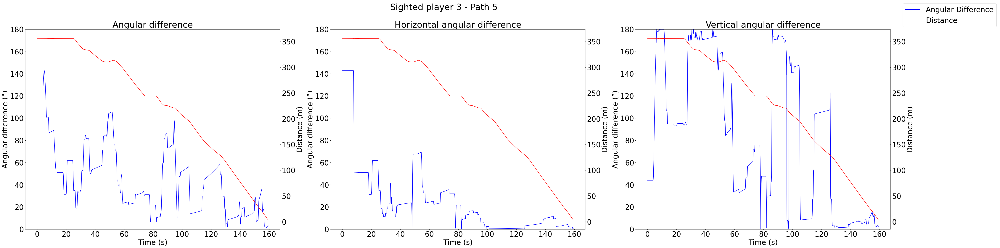

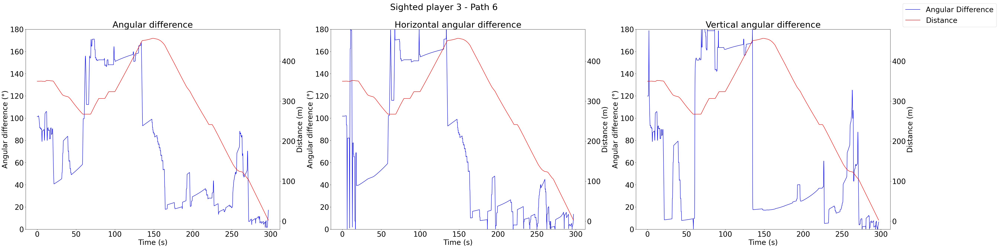

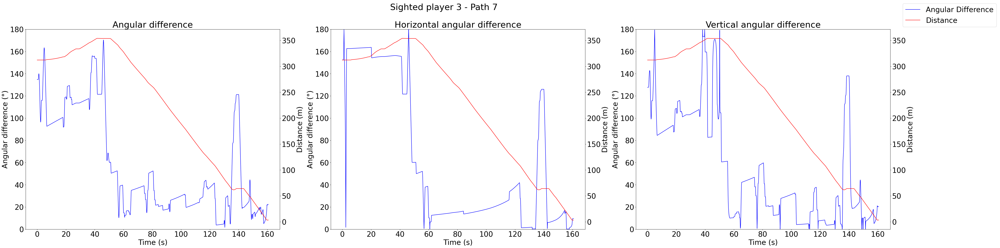

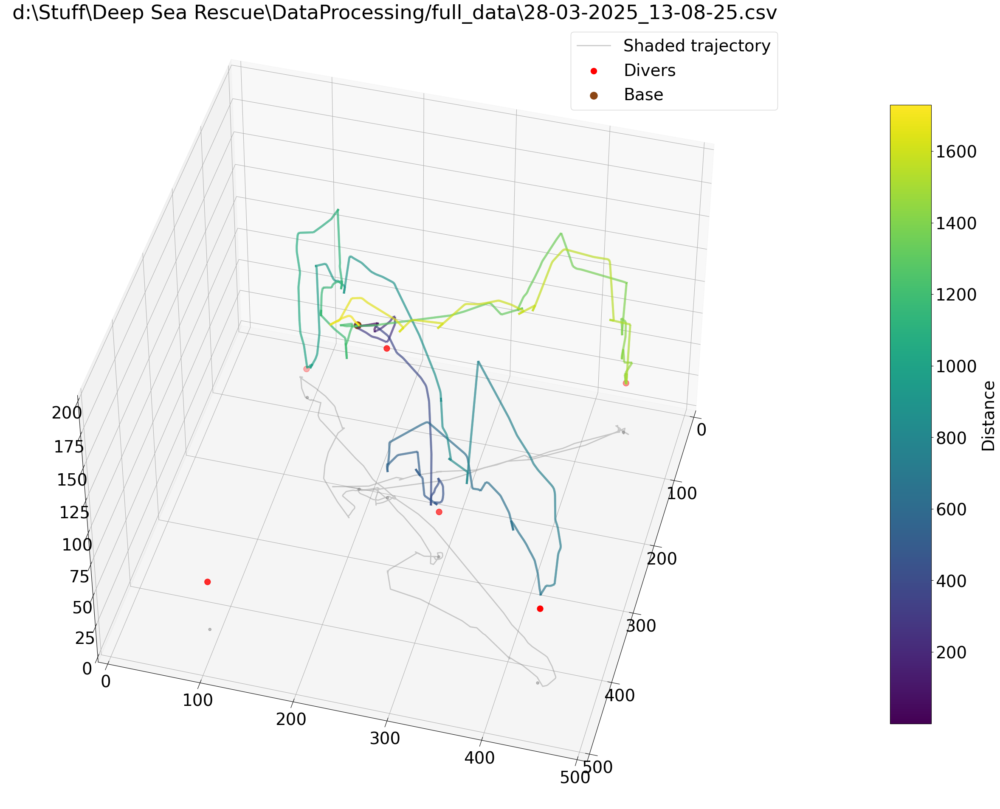

[0, 13620, 24383, 33924, 50101, 74892, 86438]


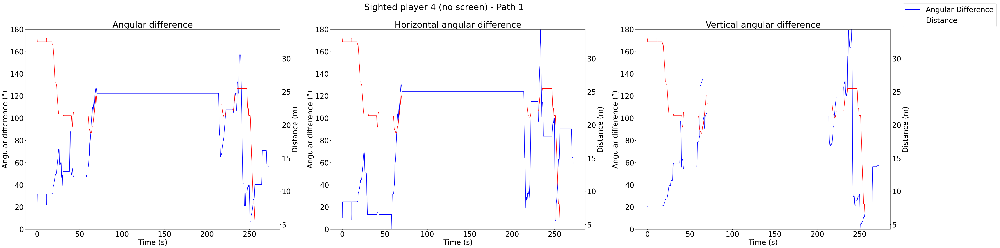

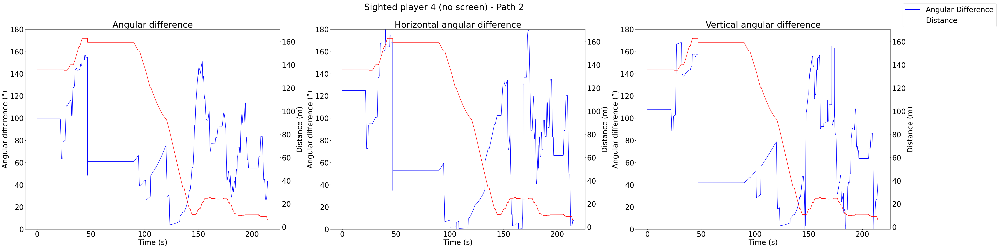

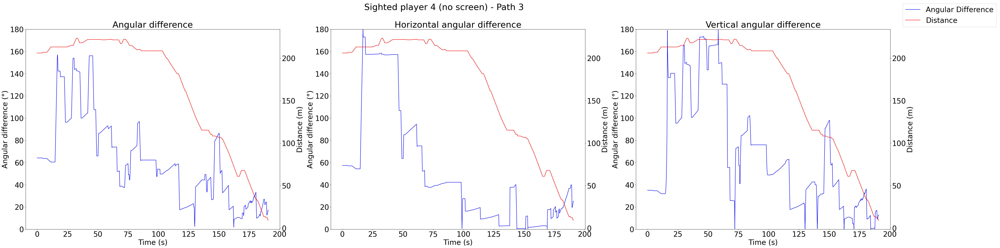

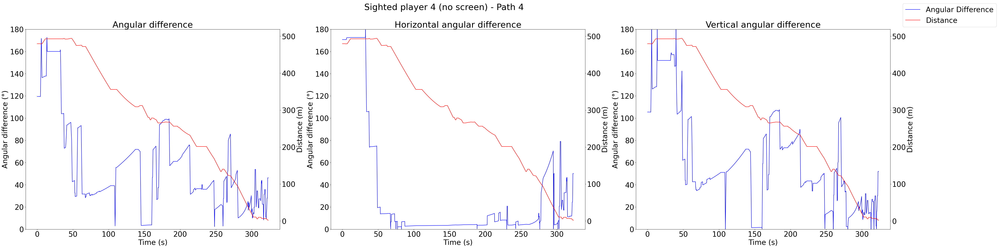

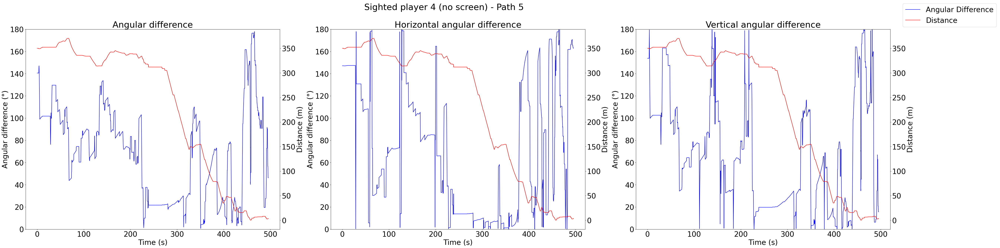

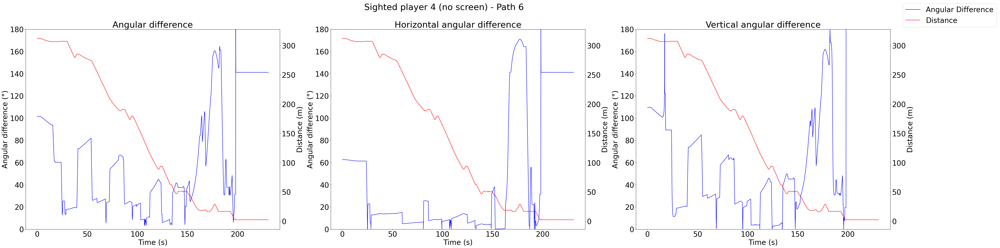

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import glob
from mpl_toolkits.mplot3d.art3d import Line3DCollection
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib as mpl
import scipy.spatial.transform as tf

'''
TestingDiver (1.)   212.271439,119.490868,219.693787
Diver1              281.881012,36.8699989,294.869995
Diver2              87.8600006,23.5,94.5
Diver3              50.2999992,40.2999992,442.5
Diver4              443.540009,39.0499992,90.5899963
Diver5              427.019989,60.6500015,438.25
base                207.893082,131.025192,187.043793

11-02-2025 10-24-56 Testing 1 5 base (0, 1, 5, 6)
11-02-2025 11-43-22 Testing 1 5 base 2 (0, 1, 5, 6, 2)
11-02-2025 13-52-54 Testing 1 base 2 (0, 1, 6, 2)
16-12-2024 14-07-40 Testing 1 base (0, 1, 6)
19-12-2024 11-54-36 Testing 1 3 base 2 (0, 1, 3, 6, 2)
'''

naming = {}
naming["11-02-2025_10-24-56_processed.csv"] = "Visually impaired player 1"
naming["11-02-2025_11-43-22_processed.csv"] = "Visually impaired player 2"
naming["11-02-2025_13-52-54_processed.csv"] = "Visually impaired player 3"
naming["16-12-2024_14-07-40_processed.csv"] = "Visually impaired player 4"
naming["19-12-2024_11-54-36_processed.csv"] = "Visually impaired player 5"
naming["23-03-2025_21-33-31_processed.csv"] = "Sighted player 1"
naming["25-03-2025_19-17-19_processed.csv"] = "Sighted player 2"
naming["27-03-2025_10-15-21_processed.csv"] = "Sighted player 3"
naming["28-03-2025_13-08-25_processed.csv"] = "Sighted player 4 (no screen)"
naming["03-04-2025_17-02-37_processed.csv"] = "Sighted player 5 (no screen)"
naming["03-04-2025_17-27-39_processed.csv"] = "Sighted player 5"

ordering = {}
ordering["11-02-2025_10-24-56.csv"] = [0, 1, 5, 6]
ordering["11-02-2025_11-43-22.csv"] = [0, 1, 5, 2, 6] #015 6 2
ordering["11-02-2025_13-52-54.csv"] = [0, 1, 2, 6]
ordering["16-12-2024_14-07-40.csv"] = [0, 1, 6]
ordering["19-12-2024_11-54-36.csv"] = [0, 1, 3, 2, 6]
ordering["23-03-2025_21-33-31.csv"] = [0, 1, 5, 3, 2, 4, 6] #01532 6 46
ordering["25-03-2025_19-17-19.csv"] = [0, 1, 5, 2, 4, 3, 6]
ordering["27-03-2025_10-15-21.csv"] = [0, 5, 1, 4, 2, 3, 6] #05142 6 36
ordering["28-03-2025_13-08-25.csv"] = [0, 1, 5, 2, 3, 6]
ordering["03-04-2025_17-02-37.csv"] = [ 0, 2, 1, 6],
ordering["03-04-2025_17-27-39.csv"] = [ 0, 1, 5, 2, 4, 3, 6]

def load_csv_to_numpy(file_path):
    df = pd.read_csv(file_path)
    data_array = df.to_numpy()
    return data_array.transpose()

def convert_quat_to_vector(quaternion):
    # Convert quaternion to a rotation object
    rotation = tf.Rotation.from_quat(quaternion)  # [x, y, z, w]
    
    # Apply quaternion to a reference forward vector to get 3D vector
    reference_vector = rotation.apply([0, 0, 1])  # Change this if needed

    # Normalize the reference vector
    reference_vector = reference_vector / np.linalg.norm(reference_vector)
    
    return reference_vector

def compute_angle_with_quaternion(pos_a, pos_b, reference_vector):
    # Compute direction vector from A to B
    direction = pos_b - pos_a
    direction = direction / np.linalg.norm(direction)  # Normalize

    # Compute dot product
    dot_product = np.dot(direction, reference_vector)

    # Clamp to avoid floating-point errors
    dot_product = np.clip(dot_product, -1.0, 1.0)

    # Compute angle in degrees
    angle_rad = np.arccos(dot_product)
    angle_deg = np.degrees(angle_rad)

    #print(f"Got {angle_deg} from comparing {direction} with {reference_vector}")

    return angle_deg

def plot_trajectory(data, name):
    fig = plt.figure() # param figsize=(15, 5)
    fig.set_size_inches(50, 30)
    ax = fig.add_subplot(121, projection='3d')
    ax.set_xlim([0, 500])
    ax.set_ylim([0, 500])
    ax.set_zlim([0, 200])

    #ax.plot3D(data[0], data[2], data[1], color='blue', linewidth=2, label="Trajectory")

    # Compute the segments for the trajectory
    points = np.array([data[0], data[2], data[1]]).T  # Convert to (N, 3)
    segments = np.array([points[:-1], points[1:]]).transpose(1, 0, 2)  # Line segments
    
    # Normalize distance for colormap scaling
    norm = mcolors.Normalize(vmin=np.min(data[4]), vmax=np.max(data[4]))  
    cmap = mpl.colormaps["viridis"]  # Choose a colormap
    colors = [cmap(norm(d)) for d in data[4][:-1]]  # Map distance to colors

    # Create a colored 3D line collection
    line = Line3DCollection(segments, colors=colors, linewidth=3.5)
    ax.add_collection3d(line)  # Add trajectory to plot

    ax.plot3D(data[0], data[2], 0, color='grey', linewidth=2, alpha=0.4, label='Shaded trajectory')
    ax.scatter3D(diver_positions[0], diver_positions[2], diver_positions[1], color='red', label='Divers', s=100)
    ax.scatter3D(base_position[0], base_position[2], base_position[1], color='saddlebrown', label='Base', s=150)
    ax.scatter3D(positions_for_plot[0], positions_for_plot[2], 0, color='grey', alpha=0.5)
    ax.set_title(name)
    ax.view_init(elev=45, azim=15)

    distances = np.array(data[4], dtype=float)
    norm = mcolors.Normalize(vmin=np.min(distances), vmax=np.max(distances))
    colors = cmap(norm(distances[:-1]))

    mappable = cm.ScalarMappable(norm=norm, cmap=cmap)
    mappable.set_array(distances)  # This will now work
    fig.colorbar(mappable, ax=ax, shrink=0.5, aspect=15, pad=0.1, label='Distance')

    plt.legend()

    plt.tight_layout()
    plt.show()

def plot_angular_difference(data, name, horizontal=False, vertical=False, per_diver=False):
    angles = []
    horizontal_angles = []
    vertical_angles = []
    diver_data_positions = []
    divers_rescued = 0
    distance_steps = []
    time_steps = []

    for i in range(data.shape[1]):
        time_stamp = data[:, i]
        if time_stamp[-2] > divers_rescued:
            diver_data_positions.append(i)
            divers_rescued += 1
        curr_target = positions_for_plot[:, ordering[name][time_stamp[-2]]]
        curr_position = time_stamp[:3]
        euler_rotation = convert_quat_to_vector(time_stamp[5:9])
        angle = compute_angle_with_quaternion(curr_position, curr_target, euler_rotation)
        angles.append(angle)
        distance_steps.append(time_stamp[3])
        time_steps.append(time_stamp[4])

        if horizontal:
            horizontal_target = curr_target
            horizontal_target[1] = 0
            horizontal_position = curr_position
            horizontal_position[1] = 0
            horizontal_rotation = euler_rotation
            horizontal_rotation[0] = 0
            horizontal_angle = compute_angle_with_quaternion(horizontal_position, horizontal_target, horizontal_rotation)
            horizontal_angles.append(horizontal_angle)

        if vertical:
            vertical_target = curr_target
            vertical_target[0] = vertical_target[2] = 0
            vertical_position = curr_position
            vertical_position[0] = vertical_position[2] = 0
            vertical_rotation = euler_rotation
            vertical_rotation[1] = 0
            vertical_angle = compute_angle_with_quaternion(vertical_position, vertical_target, vertical_rotation)
            vertical_angles.append(vertical_angle)

    diver_data_positions.append(data.shape[1])

    if not per_diver:
        fig = plt.figure()
        ax = fig.add_subplot(311)
        ax.plot(angles)
        ax.set_title(name + " - Angles")
        ax.set_ylim([0, 180])

        if horizontal:
            ax2 = fig.add_subplot(312)
            ax2.plot(horizontal_angles)
            ax2.set_title(name + " - Horizontal angles")
            ax2.set_ylim([0, 180])

        if vertical:
            ax3 = fig.add_subplot(313)
            ax3.plot(vertical_angles)
            ax3.set_title(name + " - Vertical angles")
            ax3.set_ylim([0, 180])
    
    else:
        for i in range(divers_rescued):
            fig = plt.figure()
            ax = fig.add_subplot(311)
            ax.plot(angles[diver_data_positions[i]:diver_data_positions[i + 1]])
            ax.set_title(name + " - Angles at path " + str(i))
            ax.set_ylim([0, 180])

            if horizontal:
                ax2 = fig.add_subplot(312)
                ax2.plot(horizontal_angles[diver_data_positions[i]:diver_data_positions[i + 1]])
                ax2.set_title(name + " - Horizontal angles at path " + str(i))
                ax2.set_ylim([0, 180])

            if vertical:
                ax3 = fig.add_subplot(313)
                ax3.plot(vertical_angles[diver_data_positions[i]:diver_data_positions[i + 1]])
                ax3.set_title(name + " - Vertical angles at path " + str(i))
                ax3.set_ylim([0, 180])
            plt.tight_layout()

    plt.tight_layout()
    plt.show()

def plot_angular_difference_unity(name):
    file = open(name, "r")
    file.readline()
    #angular_data = [float(angle) for angle in file.readlines()]
    diver_indices = [0]
    angular_data = []
    distances = []
    counter = 0
    for time_stamp in file.readlines():
        separated_time_stamp = time_stamp.split(',')
        angular_data.append([float(separated_time_stamp[0]), float(separated_time_stamp[1]), float(separated_time_stamp[2])])
        distances.append(float(separated_time_stamp[3]))
        current_diver = int(separated_time_stamp[4])
        if current_diver > len(diver_indices) - 1:
            diver_indices.append(counter)
        counter += 1
    
    diver_indices.append(counter)
        
    time = []
    for i in range(len(angular_data)):
        time.append(i * 0.02)
    
    angular_data = np.array(angular_data)
    angular_data = np.transpose(angular_data)

    angles = angular_data[0]
    horizontal_angles = angular_data[1]
    vertical_angles = angular_data[2]

    print(diver_indices)

    for i in range(len(diver_indices) - 1):
        fig = plt.figure()
        fig.set_size_inches(60, 14)
        fig.suptitle(naming[name.split('\\')[-1]] + " - Path " + str(i + 1))

        ax = fig.add_subplot(131)
        ax.plot(time[0:diver_indices[i + 1] - diver_indices[i]], angles[diver_indices[i]:diver_indices[i + 1]], label="Angular Difference", color='b')
        ax.set_title("Angular difference")
        ax.set_ylim([0, 180])
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Angular difference (°)')

        ax_dist = ax.twinx()
        ax_dist.plot(time[0:diver_indices[i + 1] - diver_indices[i]], distances[diver_indices[i]:diver_indices[i + 1]], label="Distance", color='r')
        ax_dist.set_ylabel('Distance (m)')

        ax_hori = fig.add_subplot(132)
        ax_hori.plot(time[0:diver_indices[i + 1] - diver_indices[i]], horizontal_angles[diver_indices[i]:diver_indices[i + 1]], color='b')
        ax_hori.set_title("Horizontal angular difference")
        ax_hori.set_ylim([0, 180])
        ax_hori.set_xlabel('Time (s)')
        ax_hori.set_ylabel('Angular difference (°)')

        ax_dist_hori = ax_hori.twinx()
        ax_dist_hori.plot(time[0:diver_indices[i + 1] - diver_indices[i]], distances[diver_indices[i]:diver_indices[i + 1]], color='r')
        ax_dist_hori.set_ylabel('Distance (m)')

        ax_vert = fig.add_subplot(133)
        ax_vert.plot(time[0:diver_indices[i + 1] - diver_indices[i]], vertical_angles[diver_indices[i]:diver_indices[i + 1]], color='b')
        ax_vert.set_title("Vertical angular difference")
        ax_vert.set_ylim([0, 180])
        ax_vert.set_xlabel('Time (s)')
        ax_vert.set_ylabel('Angular difference (°)')

        ax_dist_vert = ax_vert.twinx()
        ax_dist_vert.plot(time[0:diver_indices[i + 1] - diver_indices[i]], distances[diver_indices[i]:diver_indices[i + 1]], color='r')
        ax_dist_vert.set_ylabel('Distance (m)')

        fig.legend()

diver_positions = np.array([
    [212.271439,119.490868,219.693787],
    [281.881012,36.8699989,294.869995],
    [87.8600006,23.5,94.5],
    [50.2999992,40.2999992,442.5],
    [443.540009,39.0499992,90.5899963],
    [427.019989,60.6500015,438.25]
    ])
diver_positions = np.transpose(diver_positions)

base_position = np.array([207.893082,131.025192,187.043793])
base_position = np.transpose(base_position)

positions_for_plot = np.array([
    [212.271439,119.490868,219.693787],
    [281.881012,36.8699989,294.869995],
    [87.8600006,23.5,94.5],
    [50.2999992,40.2999992,442.5],
    [443.540009,39.0499992,90.5899963],
    [427.019989,60.6500015,438.25],
    [207.893082,131.025192,187.043793]
    ])
positions_for_plot = np.transpose(positions_for_plot)

script_dir = os.path.dirname(os.path.abspath(__file__))
csv_files = glob.glob(os.path.join(script_dir + "/full_data", "*.csv"))
processed_csv_files = glob.glob(os.path.join(script_dir + "/processed_data", "*.csv"))
txt_files = glob.glob(os.path.join(script_dir + "/processed_data", "*.txt"))

plt.rcParams.update({'font.size': 28})

#data = load_csv_to_numpy(csv_files[1])
#plot_trajectory(data, os.path.basename(csv_files[1]))
#plot_angular_difference_unity(processed_csv_files[1])
#plot_angular_difference(data, os.path.basename(csv_files[1]), horizontal=True, vertical=False, per_diver=True)
#plot_angular_difference(data, os.path.basename(csv_files[1]), horizontal=True, vertical=True, per_diver=True)


counter = 0
for file_path in csv_files:
    data = load_csv_to_numpy(file_path)
    plot_trajectory(data, file_path)
    plot_angular_difference_unity(processed_csv_files[counter])
    #plot_angular_difference(data, os.path.basename(file_path), per_diver=True)'
    counter += 1